<span style="font-size: 23px;"> Decision Tree Model for predicting Heart Attack Risk<span>

In [662]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pydotplus, graphviz
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_graphviz
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from six import StringIO  
from IPython.display import Image
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import OneHotEncoder
import warnings 
import pickle
warnings.filterwarnings("ignore")

<span style="font-size: 18px;">1. Load the data from CSV<span>

In [663]:
data = pd.read_csv('../US_Heart_Patients.csv')

<span style="font-size: 18px;">2. Perform the exploratory data analysis<span>


2.1. Showing first 10 rows of the data

In [664]:
data.head(10)

,Gender,age,education,currentSmoker,cigsPerDay,BP Meds,prevalentStroke,prevalentHyp,diabetes,tot cholesterol,Systolic BP,Diastolic BP,BMI,heartRate,glucose,Heart-Att
0,Male,39.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,195.0,106.0,70.0,26.97,80.0,77.0,0
1,Female,46.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,250.0,121.0,81.0,28.73,95.0,76.0,0
2,Male,48.0,1.0,1.0,20.0,0.0,0.0,0.0,0.0,245.0,127.5,80.0,25.34,75.0,70.0,0
3,Female,61.0,3.0,1.0,30.0,0.0,0.0,1.0,0.0,225.0,150.0,95.0,28.58,65.0,103.0,1
4,Female,46.0,3.0,1.0,23.0,0.0,0.0,0.0,0.0,285.0,130.0,84.0,23.10,85.0,85.0,0
5,Female,43.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,228.0,180.0,110.0,30.30,77.0,99.0,0
6,Female,63.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,205.0,138.0,71.0,33.11,60.0,85.0,1
7,Female,45.0,2.0,1.0,20.0,0.0,0.0,0.0,0.0,313.0,100.0,71.0,21.68,79.0,78.0,0
8,Male,52.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,260.0,141.5,89.0,26.36,76.0,79.0,0
9,Male,43.0,1.0,1.0,30.0,0.0,0.0,1.0,0.0,225.0,162.0,107.0,23.61,93.0,88.0,0


2.2. Check the shape i.e. dimension of data

In [665]:
data.shape

(4240, 16)

2.3. 5-point summary (like Median, 25%, 75%, Minimum and Maximum)

In [666]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
age,4238.0,49.579283,8.572875,32.00,42.00,49.000,56.00,70.0
education,4130.0,1.979903,1.019943,1.00,1.00,2.000,3.00,4.0
currentSmoker,4237.0,0.494218,0.500026,0.00,0.00,0.000,1.00,1.0
cigsPerDay,4209.0,9.001901,11.920742,0.00,0.00,0.000,20.00,70.0
BP Meds,4180.0,0.029665,0.169682,0.00,0.00,0.000,0.00,1.0
prevalentStroke,4231.0,0.005909,0.076650,0.00,0.00,0.000,0.00,1.0
prevalentHyp,4238.0,0.310524,0.462763,0.00,0.00,0.000,1.00,1.0
diabetes,4238.0,0.025720,0.158316,0.00,0.00,0.000,0.00,1.0
tot cholesterol,4180.0,236.677273,44.616098,107.00,206.00,234.000,263.00,696.0
Systolic BP,4236.0,132.362370,22.039244,83.50,117.00,128.000,144.00,295.0


2.4. Information about the column (data types)

In [667]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4240 entries, 0 to 4239
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Gender           4232 non-null   object 
 1   age              4238 non-null   float64
 2   education        4130 non-null   float64
 3   currentSmoker    4237 non-null   float64
 4   cigsPerDay       4209 non-null   float64
 5   BP Meds          4180 non-null   float64
 6   prevalentStroke  4231 non-null   float64
 7   prevalentHyp     4238 non-null   float64
 8   diabetes         4238 non-null   float64
 9   tot cholesterol  4180 non-null   float64
 10  Systolic BP      4236 non-null   float64
 11  Diastolic BP     4235 non-null   float64
 12  BMI              4216 non-null   float64
 13  heartRate        4236 non-null   float64
 14  glucose          3849 non-null   float64
 15  Heart-Att        4240 non-null   int64  
dtypes: float64(14), int64(1), object(1)
memory usage: 530.1+ KB


2.5. Check the How many rows of data are having heart risk

In [668]:
data['Heart-Att'].value_counts()       

Heart-Att
0    3596
1     644
Name: count, dtype: int64

2.6. Check if any duplicate rows present or now

In [669]:
data.duplicated().sum()

0

2.7. Number of outliers

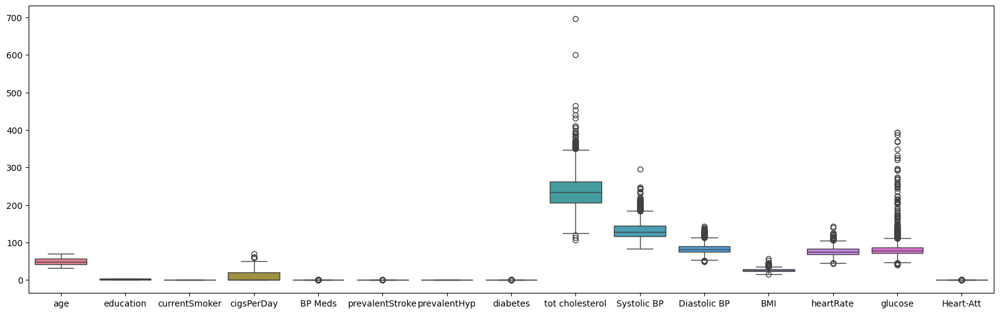

In [670]:
plt.figure(figsize=(20, 6))
sns.boxplot(data=data)
plt.show()

2.8. Any missing value

In [671]:
print(data.isnull().sum())

Gender               8
age                  2
education          110
currentSmoker        3
cigsPerDay          31
BP Meds             60
prevalentStroke      9
prevalentHyp         2
diabetes             2
tot cholesterol     60
Systolic BP          4
Diastolic BP         5
BMI                 24
heartRate            4
glucose            391
Heart-Att            0
dtype: int64


2.9. Categorical Treatment One hot encoding

In [672]:
data['Gender'].replace({"Male":1, "Female":0}, inplace=True)
data.head(10)

,Gender,age,education,currentSmoker,cigsPerDay,BP Meds,prevalentStroke,prevalentHyp,diabetes,tot cholesterol,Systolic BP,Diastolic BP,BMI,heartRate,glucose,Heart-Att
0,1.0,39.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,195.0,106.0,70.0,26.97,80.0,77.0,0
1,0.0,46.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,250.0,121.0,81.0,28.73,95.0,76.0,0
2,1.0,48.0,1.0,1.0,20.0,0.0,0.0,0.0,0.0,245.0,127.5,80.0,25.34,75.0,70.0,0
3,0.0,61.0,3.0,1.0,30.0,0.0,0.0,1.0,0.0,225.0,150.0,95.0,28.58,65.0,103.0,1
4,0.0,46.0,3.0,1.0,23.0,0.0,0.0,0.0,0.0,285.0,130.0,84.0,23.10,85.0,85.0,0
5,0.0,43.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,228.0,180.0,110.0,30.30,77.0,99.0,0
6,0.0,63.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,205.0,138.0,71.0,33.11,60.0,85.0,1
7,0.0,45.0,2.0,1.0,20.0,0.0,0.0,0.0,0.0,313.0,100.0,71.0,21.68,79.0,78.0,0
8,1.0,52.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,260.0,141.5,89.0,26.36,76.0,79.0,0
9,1.0,43.0,1.0,1.0,30.0,0.0,0.0,1.0,0.0,225.0,162.0,107.0,23.61,93.0,88.0,0


2.10. Correlation between variables

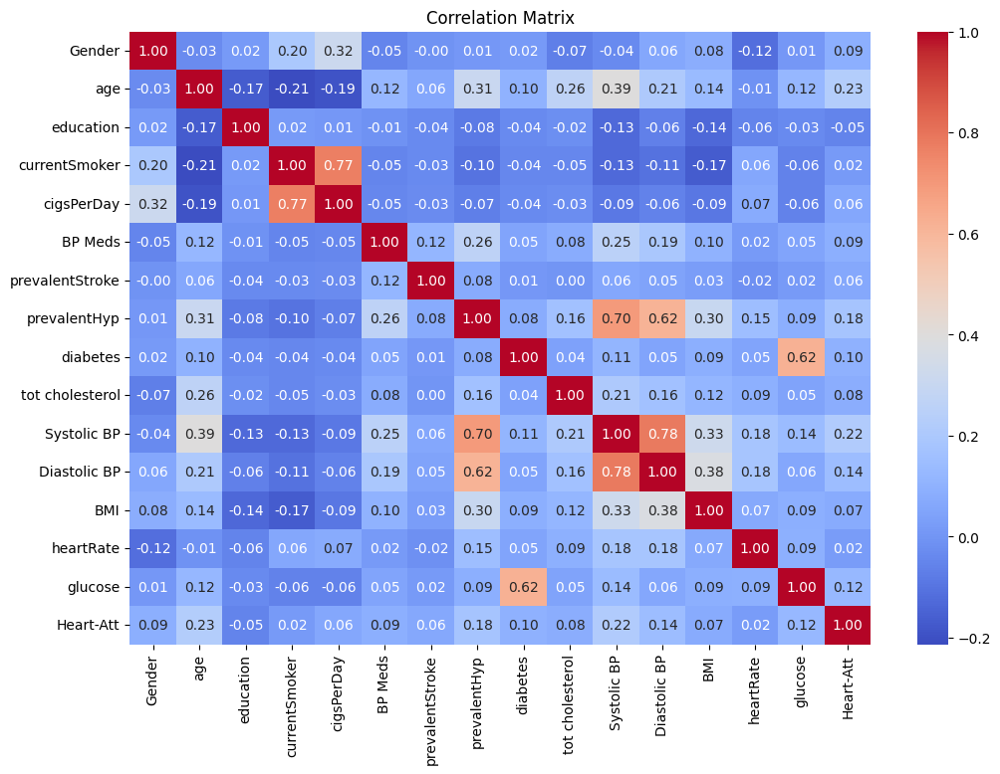

In [673]:
correlation_matrix = data.corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix")
plt.show()

2.11. Distribution of Variables

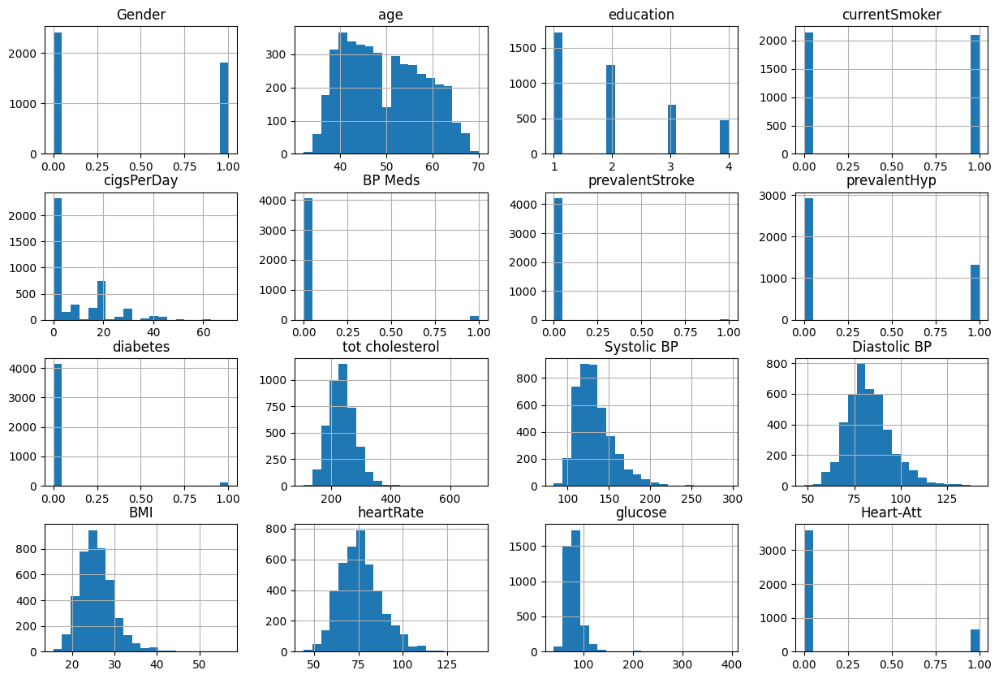

In [674]:
data.hist(figsize=(15, 10), bins=20)
plt.show()

<span style="font-size: 18px;">3. Data Preprocessing <span>

3.1. Impute the missing values (if any).

In [675]:
print(data.isnull().sum())

Gender               8
age                  2
education          110
currentSmoker        3
cigsPerDay          31
BP Meds             60
prevalentStroke      9
prevalentHyp         2
diabetes             2
tot cholesterol     60
Systolic BP          4
Diastolic BP         5
BMI                 24
heartRate            4
glucose            391
Heart-Att            0
dtype: int64


In [676]:
imputer = SimpleImputer(strategy='mean')
data_imputed = pd.DataFrame(imputer.fit_transform(data), columns=data.columns)
print(data_imputed.isnull().sum())
data = data_imputed

Gender             0
age                0
education          0
currentSmoker      0
cigsPerDay         0
BP Meds            0
prevalentStroke    0
prevalentHyp       0
diabetes           0
tot cholesterol    0
Systolic BP        0
Diastolic BP       0
BMI                0
heartRate          0
glucose            0
Heart-Att          0
dtype: int64


3.2. Outlier treatment

3.2.1 Checking the outlier before treatment

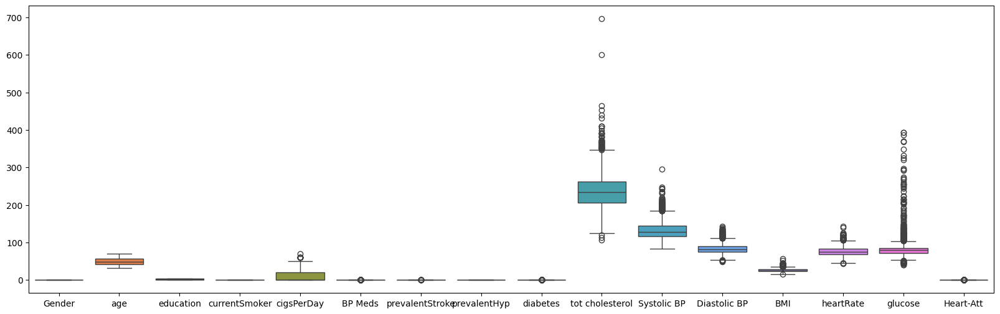

In [677]:
plt.figure(figsize=(20, 6))
sns.boxplot(data=data)
plt.show()

3.2.2 Removing Outliers 

In [678]:
def outlier_cap(col):
    sorted(col)
    Q1, Q3 =np.percentile(col,[25,75])
    IQR = Q3 - Q1
    lower_range = Q1 - (1.5*IQR)
    upper_range = Q3 + (1.5*IQR)
    return lower_range, upper_range

In [679]:
for column in data.columns[:-1].tolist():
    lr, ur =outlier_cap(data[column])
    data[column] =np.where(data[column]>ur , ur,data[column])
    data[column] =np.where(data[column]<lr , lr,data[column])

3.2.3 Showing box plot after removing all outliers

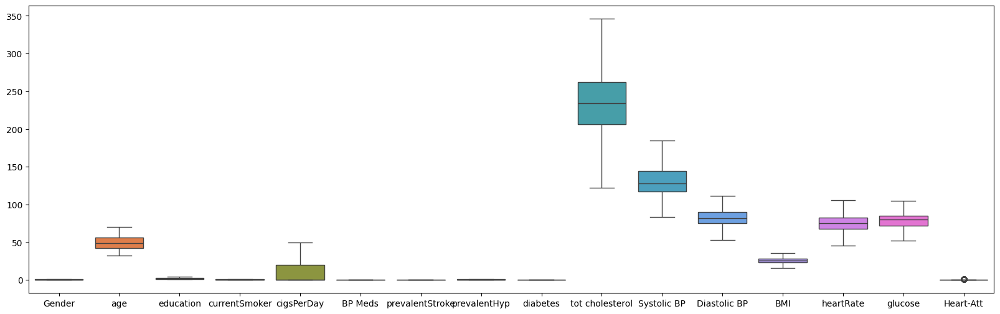

In [680]:
plt.figure(figsize=(20, 6))
sns.boxplot(data=data)
plt.show()

<span style="font-size: 18px;">4. Split the dataset<span>

4.1. Spliting feature and response 

In [681]:
# Putting feature variable to X
X = data.drop(columns=['Heart-Att'],axis=1)

# Putting response variable to y
y = data['Heart-Att']

4.2. Split the data into 80% training dataset and 20% test dataset

In [682]:
X_train, X_test, y_train, y_test = train_test_split(X,y,train_size=0.8, random_state=42)
X_train.shape, X_test.shape

((3392, 15), (848, 15))

<span style="font-size: 18px;">5. Model preparation and evaluation<span>

5.1. Train the model with test data ( without hyper-parameters )

In [683]:
dt_default = DecisionTreeClassifier(random_state=42)
dt_default.fit(X_train, y_train)

DecisionTreeClassifier(random_state=42)

  5.2. Creating helper function and plotting the decision tree

In [684]:
def get_dt_graph(dt_classifier):
    dot_data = StringIO()
    export_graphviz(dt_classifier, out_file=dot_data, filled=True, rounded=True,
                    feature_names=X.columns, 
                    class_names=['Risk', 'No Risk'])
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
    return graph

In [685]:
gph = get_dt_graph(dt_default)
Image(gph.create_png())

5.3. Creating confusion matrix to evaluate the performance

In [686]:
def evaluate_model(dt_classifier):
    print("Train Accuracy :", accuracy_score(y_train, dt_classifier.predict(X_train)))
    print("Train Confusion Matrix:")
    print(confusion_matrix(y_train, dt_classifier.predict(X_train)))
    print("-"*50)
    print("Test Accuracy :", accuracy_score(y_test, dt_classifier.predict(X_test)))
    print("Test Confusion Matrix:")
    print(confusion_matrix(y_test, dt_classifier.predict(X_test)))
    print(classification_report(y_test, dt_classifier.predict(X_test)))

In [687]:
evaluate_model(dt_default)

Train Accuracy : 1.0
Train Confusion Matrix:
[[2871    0]
 [   0  521]]
--------------------------------------------------
Test Accuracy : 0.7653301886792453
Test Confusion Matrix:
[[616 109]
 [ 90  33]]
              precision    recall  f1-score   support

         0.0       0.87      0.85      0.86       725
         1.0       0.23      0.27      0.25       123

    accuracy                           0.77       848
   macro avg       0.55      0.56      0.55       848
weighted avg       0.78      0.77      0.77       848



<span style="font-size: 18px;">6. Finding the best model with Hyper-parameter<span>

6.1. Controlling the depth of the tree  

In [688]:
dt_depth = DecisionTreeClassifier(max_depth=3)
dt_depth.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=3)

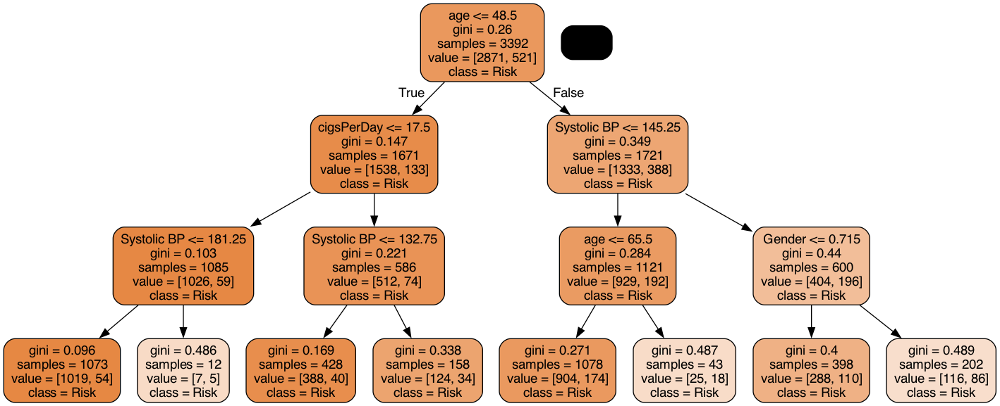

In [689]:
gph = get_dt_graph(dt_depth)
Image(gph.create_png())

In [690]:
evaluate_model(dt_depth)

Train Accuracy : 0.8464033018867925
Train Confusion Matrix:
[[2871    0]
 [ 521    0]]
--------------------------------------------------
Test Accuracy : 0.8549528301886793
Test Confusion Matrix:
[[725   0]
 [123   0]]
              precision    recall  f1-score   support

         0.0       0.85      1.00      0.92       725
         1.0       0.00      0.00      0.00       123

    accuracy                           0.85       848
   macro avg       0.43      0.50      0.46       848
weighted avg       0.73      0.85      0.79       848



6.2. Controlling minimum samples before split 

In [691]:
dt_min_split = DecisionTreeClassifier(min_samples_split=25)
dt_min_split.fit(X_train, y_train)

DecisionTreeClassifier(min_samples_split=25)

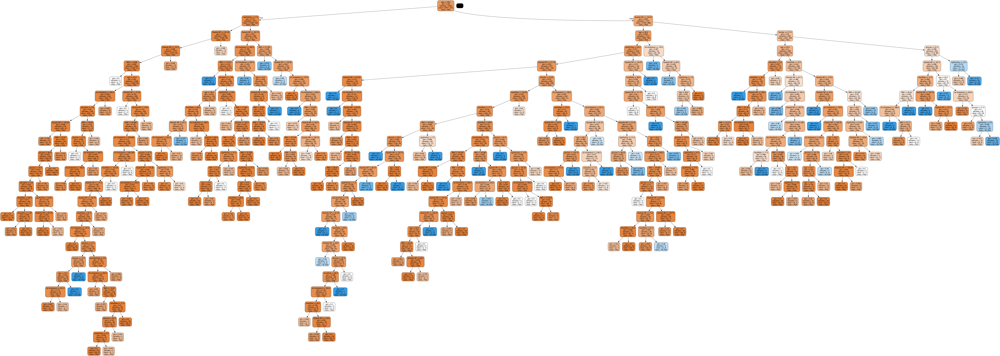

In [692]:
gph = get_dt_graph(dt_min_split)
Image(gph.create_png())

In [693]:
evaluate_model(dt_depth)

Train Accuracy : 0.8464033018867925
Train Confusion Matrix:
[[2871    0]
 [ 521    0]]
--------------------------------------------------
Test Accuracy : 0.8549528301886793
Test Confusion Matrix:
[[725   0]
 [123   0]]
              precision    recall  f1-score   support

         0.0       0.85      1.00      0.92       725
         1.0       0.00      0.00      0.00       123

    accuracy                           0.85       848
   macro avg       0.43      0.50      0.46       848
weighted avg       0.73      0.85      0.79       848



6.3. Controlling minimum samples of leaf node 

In [694]:
dt_min_leaf = DecisionTreeClassifier(min_samples_leaf=20, random_state=42)
dt_min_leaf.fit(X_train, y_train)

DecisionTreeClassifier(min_samples_leaf=20, random_state=42)

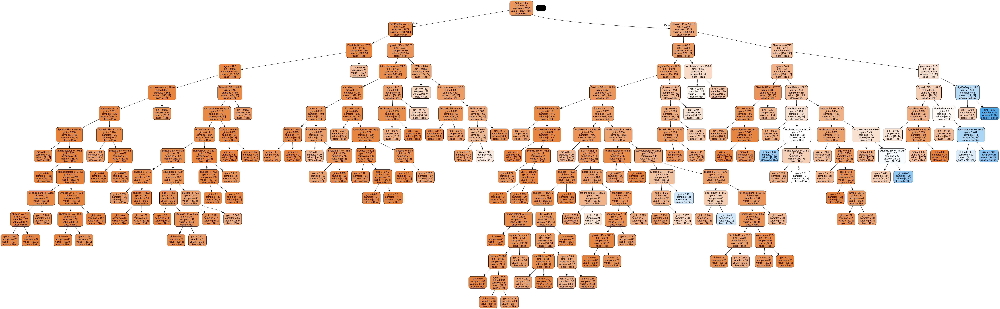

In [695]:
gph = get_dt_graph(dt_min_leaf)
Image(gph.create_png())

In [696]:
evaluate_model(dt_min_leaf)

Train Accuracy : 0.8614386792452831
Train Confusion Matrix:
[[2821   50]
 [ 420  101]]
--------------------------------------------------
Test Accuracy : 0.8502358490566038
Test Confusion Matrix:
[[714  11]
 [116   7]]
              precision    recall  f1-score   support

         0.0       0.86      0.98      0.92       725
         1.0       0.39      0.06      0.10       123

    accuracy                           0.85       848
   macro avg       0.62      0.52      0.51       848
weighted avg       0.79      0.85      0.80       848



6.4. Using Entrophy instead of gini index

In [697]:
dt_min_leaf_entrophy = DecisionTreeClassifier(min_samples_leaf=20, random_state=42, criterion='entropy')
dt_min_leaf_entrophy.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', min_samples_leaf=20,
                       random_state=42)

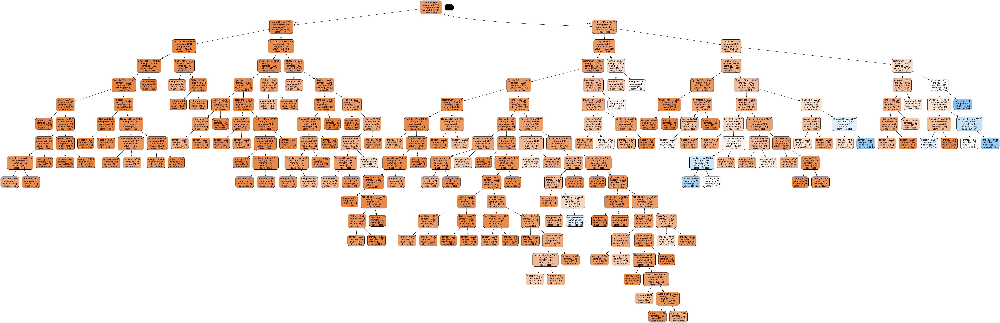

In [698]:
gph = get_dt_graph(dt_min_leaf_entrophy)
Image(gph.create_png())

In [699]:
evaluate_model(dt_min_leaf)

Train Accuracy : 0.8614386792452831
Train Confusion Matrix:
[[2821   50]
 [ 420  101]]
--------------------------------------------------
Test Accuracy : 0.8502358490566038
Test Confusion Matrix:
[[714  11]
 [116   7]]
              precision    recall  f1-score   support

         0.0       0.86      0.98      0.92       725
         1.0       0.39      0.06      0.10       123

    accuracy                           0.85       848
   macro avg       0.62      0.52      0.51       848
weighted avg       0.79      0.85      0.80       848



<span style="font-size: 18px;">7. Hyper parameter tuning for finding best model<span>

In [700]:
dt = DecisionTreeClassifier(random_state=42)

In [898]:
# Create the parameter grid based on the results of random search 
params = {
    'max_depth': [5, 10, 20, 30],  
    'min_samples_leaf': [20, 40, 60, 100],
    'criterion': ["gini", "entropy"]
}

In [899]:
# Instantiate the grid search model
grid_search = GridSearchCV(estimator=dt, 
                           param_grid=params, 
                           cv=4, n_jobs=-1, verbose=1, scoring = "accuracy")

In [900]:
%%time
grid_search.fit(X_train, y_train)

Fitting 4 folds for each of 32 candidates, totalling 128 fits
CPU times: user 102 ms, sys: 30.5 ms, total: 133 ms
Wall time: 339 ms


GridSearchCV(cv=4, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [5, 10, 20, 30],
                         'min_samples_leaf': [20, 40, 60, 100]},
             scoring='accuracy', verbose=1)

In [901]:
score_df = pd.DataFrame(grid_search.cv_results_)
score_df.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,0.010117,0.002460,0.002048,0.000989,gini,5,20,"{'criterion': 'gini', 'max_depth': 5, 'min_sam...",0.834906,0.836085,0.834906,0.852594,0.839623,0.007505,25
1,0.010947,0.003550,0.002331,0.001043,gini,5,40,"{'criterion': 'gini', 'max_depth': 5, 'min_sam...",0.844340,0.837264,0.845519,0.845519,0.843160,0.003438,9
2,0.006998,0.001330,0.001446,0.000708,gini,5,60,"{'criterion': 'gini', 'max_depth': 5, 'min_sam...",0.840802,0.837264,0.845519,0.845519,0.842276,0.003476,17
3,0.008700,0.002116,0.001707,0.000751,gini,5,100,"{'criterion': 'gini', 'max_depth': 5, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
4,0.012523,0.001651,0.002063,0.000317,gini,10,20,"{'criterion': 'gini', 'max_depth': 10, 'min_sa...",0.843160,0.830189,0.824292,0.846698,0.836085,0.009172,30


In [902]:
score_df.nlargest(5,"mean_test_score")

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
3,0.008700,0.002116,0.001707,0.000751,gini,5,100,"{'criterion': 'gini', 'max_depth': 5, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
7,0.013144,0.006231,0.001232,0.000190,gini,10,100,"{'criterion': 'gini', 'max_depth': 10, 'min_sa...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
11,0.009625,0.005916,0.001403,0.000946,gini,20,100,"{'criterion': 'gini', 'max_depth': 20, 'min_sa...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
15,0.005689,0.001455,0.000787,0.000130,gini,30,100,"{'criterion': 'gini', 'max_depth': 30, 'min_sa...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
19,0.014430,0.013386,0.001747,0.001596,entropy,5,100,"{'criterion': 'entropy', 'max_depth': 5, 'min_...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1


In [903]:
grid_search.best_estimator_

DecisionTreeClassifier(max_depth=5, min_samples_leaf=100, random_state=42)

In [904]:
dt_best = grid_search.best_estimator_

In [905]:
evaluate_model(dt_best)

Train Accuracy : 0.8475825471698113
Train Confusion Matrix:
[[2823   48]
 [ 469   52]]
--------------------------------------------------
Test Accuracy : 0.8549528301886793
Test Confusion Matrix:
[[718   7]
 [116   7]]
              precision    recall  f1-score   support

         0.0       0.86      0.99      0.92       725
         1.0       0.50      0.06      0.10       123

    accuracy                           0.85       848
   macro avg       0.68      0.52      0.51       848
weighted avg       0.81      0.85      0.80       848



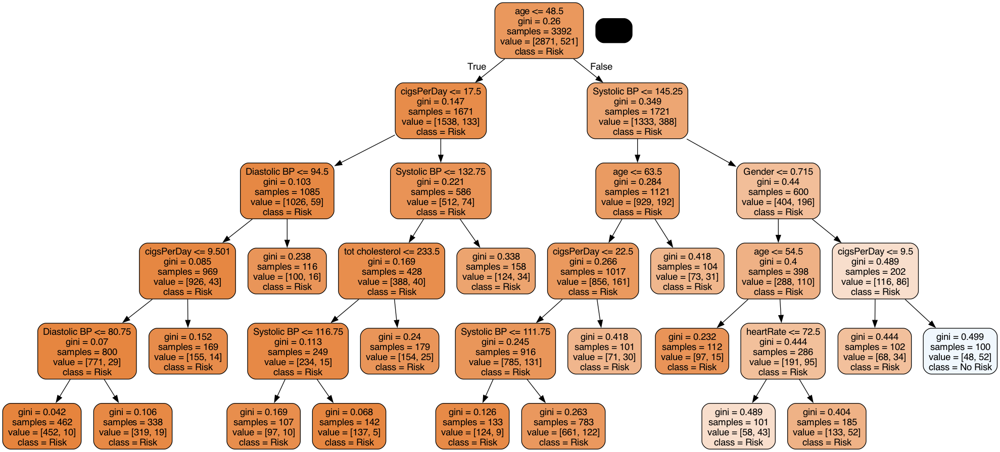

In [906]:
gph = get_dt_graph(dt_best)
Image(gph.create_png())

<span style="font-size: 18px;">8. Dumping the final model<span>

In [907]:
with open('decision_tree_model.pkl', 'wb') as f:
    pickle.dump(dt_best,f)

<span style="font-size: 18px;">9. Loading the model to test and predict data<span>

In [908]:
with open("decision_tree_model.pkl",'rb') as f:
    model_pkl = pickle.load(f)

In [909]:
X_test.head(5)

,Gender,age,education,currentSmoker,cigsPerDay,BP Meds,prevalentStroke,prevalentHyp,diabetes,tot cholesterol,Systolic BP,Diastolic BP,BMI,heartRate,glucose
1350,0.0,49.0,3.0,1.0,10.0,0.0,0.0,0.0,0.0,260.0,123.0,80.0,23.10,63.0,65.0
1434,1.0,43.0,1.0,1.0,25.0,0.0,0.0,0.0,0.0,201.0,121.0,82.0,23.84,70.0,91.0
2500,1.0,45.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,277.0,140.0,84.0,28.74,69.0,74.0
1128,0.0,63.0,3.0,1.0,10.0,0.0,0.0,1.0,0.0,236.0,184.5,103.0,27.91,60.0,74.0
4144,1.0,59.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,237.0,131.5,84.0,24.17,90.0,94.0


In [910]:
y_test.head(5)

1350    1.0
1434    0.0
2500    0.0
1128    0.0
4144    1.0
Name: Heart-Att, dtype: float64

9.1. Predicting one record from data set whose out put should be 0

Gender | age | education | currentSmoker | cigsPerDay | BP Meds | prevalentStroke | prevalentHyp | diabetes | tot cholesterol | Systolic BP | Diastolic BP | BMI  | heartRate | glucose  | 
-------|-----|-----------|---------------|------------|---------|------------------|--------------|----------|-----------------|-------------|--------------|------|-----------|---------|
  1.0  | 43.0| 1.0       | 1.0           | 25.0       | 0.0     | 0.0              | 0.0          | 0.0      | 201.0           | 121.0       | 82.0         | 23.84| 70.0      | 91.0    |



In [911]:
print(model_pkl.predict([[1.0,43.0,	1.0,1.0,25.0,0.0,0.0,0.0,0.0,201.0,121.0,82.0,23.84,70.0,91.0]]))

[0.]


9.2. Predicting one record outside data set

Gender | age | education | currentSmoker | cigsPerDay | BP Meds | prevalentStroke | prevalentHyp | diabetes | tot cholesterol | Systolic BP | Diastolic BP | BMI  | heartRate | glucose | 
-------|-----|-----------|---------------|------------|---------|------------------|--------------|----------|-----------------|-------------|--------------|------|-----------|---------|
   1.0 | 59.0| 3.0       | 1.0           | 10.0       | 0.0     | 0.0              | 0.0          | 0.0      | 210.0           | 123.0       | 80.0         | 23.10| 78.0      | 55.0    | 

In [912]:
print(dt_best.predict([[0.0,59.0,	3.0,1.0,10.0,0.0,0.0,0.0,0.0,210.0,123.0,80.0,23.10,78.0,55.0]]))

[0.]


9.3. Comparing both the model (Default vs Best) with a sample test data 

In [913]:
print(dt_default.predict([[0.0,46,1,1,15,0,0,0,0,244,98,57,24.01,84,95]]))

[1.]


In [914]:
print(dt_best.predict([[0.0,46,1,1,15,0,0,0,0,244,98,57,24.01,84,95]]))

[0.]
